In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import networkx as nx

%matplotlib inline

In [2]:
# The paths:
# entities:
course_path = '/Users/aaronwang/PycharmProjects/LLMs_n_KGs_for_Education/data/WDKG/data-main/data/extraction_data/entity/course.xlsx'
knowledge_points_path = '/Users/aaronwang/PycharmProjects/LLMs_n_KGs_for_Education/data/WDKG/data-main/data/extraction_data/entity/knowledge_points.xlsx'

# relations:
course_prerequisites_path = '/Users/aaronwang/PycharmProjects/LLMs_n_KGs_for_Education/data/WDKG/data-main/data/extraction_data/relation/prerequisites_course.xlsx'
knowledge_points_relation_path = '/Users/aaronwang/PycharmProjects/LLMs_n_KGs_for_Education/data/WDKG/data-main/data/extraction_data/relation/knowledge_points.xlsx'

In [3]:
from IPython.display import display

In [5]:
df_course = pd.read_excel(course_path)
display(df_course)

df_kp = pd.read_excel(knowledge_points_path)
display(df_kp)

,编号,名称,学分,课程性质,考核方式
0,1010,高等数学A,9.0,公共基础课,考试
1,1011,线性代数A,3.0,公共基础课,考试
2,1012,概率统计,3.0,公共基础课,考试
3,1013,大学物理B,5.0,公共基础课,考试
4,1014,物理实验,2.0,公共基础课,考试
...,...,...,...,...,...
73,5042,桥梁工程,2.0,专业选修课,考查
74,5043,BIM技术与应用,2.0,专业选修课,考查
75,5044,高级语言程序设计(C),3.0,专业基础课,考试
76,5045,理论力学B,3.0,专业基础课,考试


,zsid,知识点
0,12401,电路和电路的基本物理量
1,12402,电阻电感和电容元件
2,12403,独立电源元件
3,12404,二极管
4,12405,双极晶体管
...,...,...
132,14021,布局空间输出图形
133,14022,水利工程图的表达方法
134,14023,水利工程图的特点
135,14024,水利工程图的绘制方法


In [6]:
df_course_pre = pd.read_excel(course_prerequisites_path)
display(df_course_pre)

df_kp_to_course = pd.read_excel(knowledge_points_relation_path)
display(df_kp_to_course)

,Pre,To
0,1015,1017
1,1010,1018
2,1013,1018
3,1018,1019
4,1019,1020
...,...,...
68,1013,5037
69,1021,5037
70,5013,5039
71,5013,5042


,Course,to_zsid
0,1024,12401
1,1024,12402
2,1024,12403
3,1024,12404
4,1024,12405
...,...,...
132,1040,14021
133,1040,14022
134,1040,14023
135,1040,14024


### 可以看出，课程之间有前后关联，但是同一课程内的知识点无关联。可以考虑建立两个graph：课程与课程，以及按照知识点所属课程对知识点进行关联

In [7]:
# Create the Course KG
G_course = nx.DiGraph()

# Add edges to the graph
for _, row in df_course_pre.iterrows():
    G_course.add_edge(row['Pre'], row['To'])


# Add node features
for node in G_course.nodes():
    # Find the row in df_nodes that matches the node id
    node_data = df_course[df_course['编号'] == node].iloc[0]
    # Update the node with features from the matching row
    nx.set_node_attributes(G_course, {node: {'id': node_data['编号'], 
                                      'course_name': node_data['名称']}})

In [8]:
def graph_investigation(G_KC):
    print("Number of nodes:", G_KC.number_of_nodes())
    print("Number of edges:", G_KC.number_of_edges())
    
    print("Is the graph directed?", G_KC.is_directed())
    
    # For all nodes
    degrees = dict(G_KC.degree())
    print("Degrees:", degrees)
    
    # For directed graphs, in-degree and out-degree
    if G_KC.is_directed():
        in_degrees = dict(G_KC.in_degree())
        out_degrees = dict(G_KC.out_degree())
        print("In-degrees:", in_degrees)
        print("Out-degrees:", out_degrees)
    
    
    # For undirected graphs
    if not G_KC.is_directed():
        connected_components = list(nx.connected_components(G_KC))
        print("Connected components:", connected_components)
    
    # For directed graphs
    if G_KC.is_directed():
        strongly_connected = list(nx.strongly_connected_components(G_KC))
        weakly_connected = list(nx.weakly_connected_components(G_KC))
        print("Strongly connected components:", strongly_connected)
        print("Number of strongly connected components: ", len(strongly_connected))
        print("Weakly connected components:", weakly_connected)
        print("Number of weakly connected components: ", len(weakly_connected))

In [9]:
# check the graph properties:
graph_investigation(G_course)

Number of nodes: 46
Number of edges: 73
Is the graph directed? True
Degrees: {1015: 2, 1017: 2, 1010: 10, 1018: 5, 1013: 5, 1019: 6, 1020: 5, 1021: 3, 1012: 7, 1022: 2, 1023: 8, 1024: 2, 1026: 4, 1027: 6, 1029: 3, 1011: 1, 1031: 2, 5010: 5, 1032: 3, 1034: 6, 1033: 5, 1035: 2, 1037: 2, 1038: 3, 1040: 2, 1016: 2, 1041: 1, 1046: 1, 1036: 1, 1047: 1, 1050: 2, 5011: 1, 5012: 5, 5013: 4, 5014: 2, 5015: 5, 5018: 3, 5019: 4, 5026: 2, 5028: 1, 5029: 1, 5031: 2, 5033: 1, 5037: 3, 5039: 1, 5042: 2}
In-degrees: {1015: 0, 1017: 1, 1010: 0, 1018: 2, 1013: 0, 1019: 1, 1020: 1, 1021: 2, 1012: 0, 1022: 1, 1023: 1, 1024: 2, 1026: 3, 1027: 3, 1029: 2, 1011: 0, 1031: 2, 5010: 3, 1032: 3, 1034: 2, 1033: 4, 1035: 2, 1037: 0, 1038: 3, 1040: 1, 1016: 0, 1041: 1, 1046: 1, 1036: 0, 1047: 1, 1050: 2, 5011: 1, 5012: 4, 5013: 2, 5014: 2, 5015: 3, 5018: 3, 5019: 3, 5026: 2, 5028: 1, 5029: 0, 5031: 2, 5033: 0, 5037: 3, 5039: 1, 5042: 2}
Out-degrees: {1015: 2, 1017: 1, 1010: 10, 1018: 3, 1013: 5, 1019: 5, 1020: 4, 10

In [ ]:
from matplotlib.font_manager import FontManager

# Get a list of all available fonts
font_manager = FontManager()
available_fonts = font_manager.ttflist

# List to store fonts that support Chinese
chinese_fonts = []

# Sample Chinese text
sample_text = "测试"

# Check each font to see if it can render Chinese characters
for font in available_fonts:
    try:
        plt.text(0.5, 0.5, sample_text, fontname=font.name, fontsize=12)
        plt.savefig("/mnt/data/test.png")
        plt.clf()
        chinese_fonts.append(font.name)
    except Exception as e:
        # If an error occurs, skip to the next font
        continue

# Output the list of fonts that support Chinese
print("Chinese fonts:", chinese_fonts)

findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
findfont: Font family 'SimSong' not found.
/var/folders/nw/tldptqps6vg_083cddf8bg800000gn/T/ipykernel_4338/2285488282.py:17: UserWarning: Glyph 27979 (\N{CJK UNIFIED IDEOGRAPH-6D4B}) missing from current font.
  plt.savefig("/

In [11]:
import matplotlib
print(matplotlib.matplotlib_fname())

/Users/aaronwang/PycharmProjects/LLMs_n_KGs_for_Education/.312venv/lib/python3.12/site-packages/matplotlib/mpl-data/matplotlibrc


In [12]:
import matplotlib.font_manager as fm
fm._rebuild()

AttributeError: module 'matplotlib.font_manager' has no attribute '_rebuild'

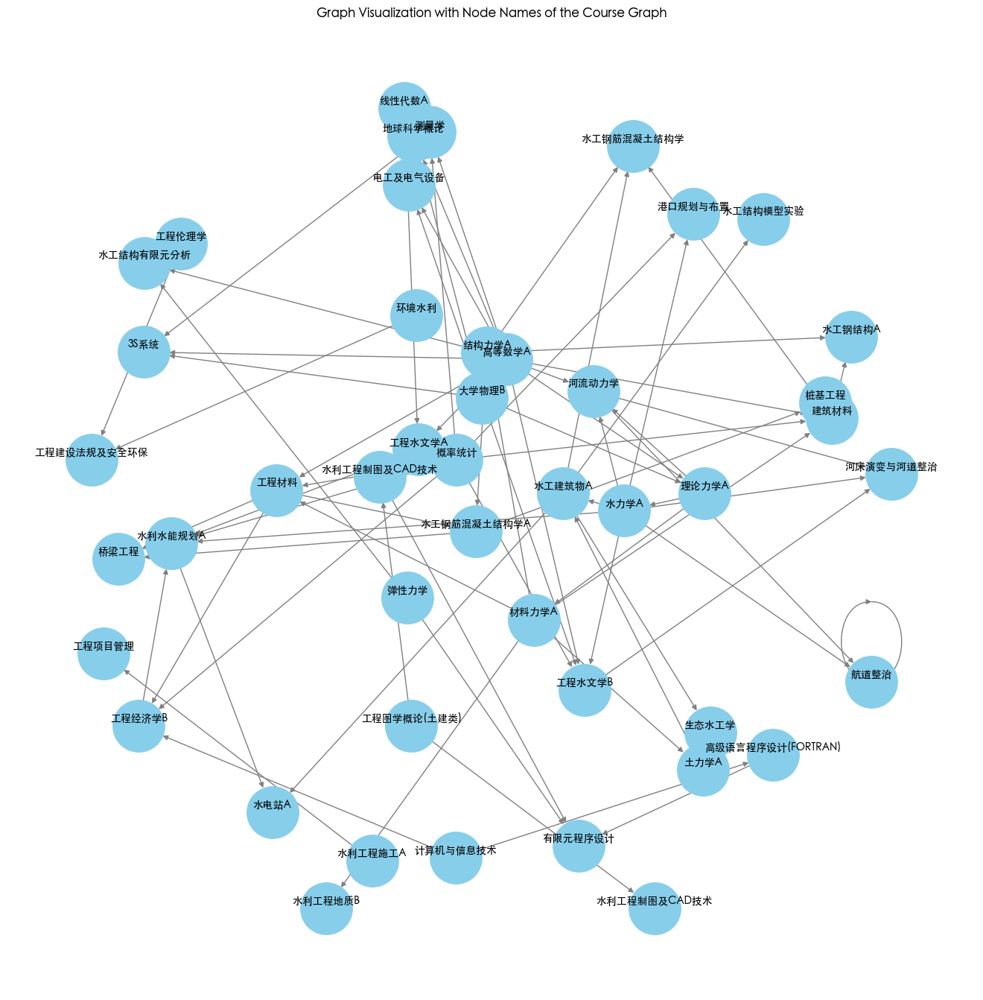

In [12]:
# Visualize:
# (including 'name' as one of the attributes for each node)
# # Set Chinese font
# plt.rcParams['font.sans-serif'] = ['SimHei']  # or any font that supports Chinese
# plt.rcParams['axes.unicode_minus'] = False  # This is needed to display the minus sign correctly
import matplotlib as mpl

matplotlib.rcParams['font.family'] = ['Heiti TC']

plt.figure(figsize=(13, 13))
# Position nodes using one of the layout algorithms
pos = nx.spring_layout(G_course, k=0.5, iterations=30)

# Draw the graph
nx.draw(G_course, pos, with_labels=False, node_color='skyblue', node_size=2500, edge_color='gray', arrows=True)

# Draw the node names as labels above the nodes
for node, (x, y) in pos.items():
    plt.text(x, y+0.01, s=G_course.nodes[node]['course_name'], horizontalalignment='center', fontsize=10)

plt.title('Graph Visualization with Node Names of the Course Graph')
plt.show()

In [13]:
# Store the course graph
# Store it:
# file_name = 'WDKG-Course.graphml'

# nx.write_graphml(G_course, file_name)

### 接下来处理知识点匹配

In [14]:
G_kp = G_course.copy()

for course in df_kp_to_course['Course'].unique():
    print('checking course : ', course)
    if course in G_kp:
        print("Found it!")
        knowledge_points = df_kp_to_course[df_kp_to_course['Course'] == course]['to_zsid'].tolist()
    
        # Find neighbors of the course node
        predecessors = list(G_kp.predecessors(course))
        successors = list(G_kp.successors(course))
    
        # Add edges from predecessors to knowledge points and from knowledge points to successors
        for kp in knowledge_points:
            G_kp.add_node(kp)
            for pred in predecessors:
                G_kp.add_edge(pred, kp)
            for succ in successors:
                G_kp.add_edge(kp, succ)
        
        # Remove the original course node
        G_kp.remove_node(course)

checking course :  1024
Found it!
checking course :  1025
checking course :  1026
Found it!
checking course :  1027
Found it!
checking course :  1029
Found it!
checking course :  1031
Found it!
checking course :  1040
Found it!


In [15]:
# check the graph properties:
graph_investigation(G_kp)

Number of nodes: 161
Number of edges: 682
Is the graph directed? True
Degrees: {1015: 16, 1017: 2, 1010: 71, 1018: 5, 1013: 21, 1019: 24, 1020: 21, 1021: 3, 1012: 39, 1022: 2, 1023: 8, 1011: 28, 5010: 21, 1032: 3, 1034: 6, 1033: 46, 1035: 2, 1037: 2, 1038: 27, 1016: 26, 1041: 1, 1046: 1, 1036: 1, 1047: 1, 1050: 2, 5011: 1, 5012: 5, 5013: 22, 5014: 2, 5015: 5, 5018: 3, 5019: 4, 5026: 2, 5028: 1, 5029: 1, 5031: 2, 5033: 1, 5037: 3, 5039: 1, 5042: 20, 12401: 2, 12402: 2, 12403: 2, 12404: 2, 12405: 2, 12406: 2, 12407: 2, 12408: 2, 12409: 2, 12410: 2, 12411: 2, 12412: 2, 12413: 2, 12414: 2, 12415: 2, 12416: 2, 12417: 2, 12601: 22, 12602: 22, 12603: 22, 12604: 22, 12605: 22, 12606: 22, 12607: 22, 12608: 22, 12609: 22, 12610: 22, 12611: 22, 12612: 22, 12613: 22, 12614: 22, 12615: 22, 12701: 20, 12702: 20, 12703: 20, 12704: 20, 12705: 20, 12706: 20, 12707: 20, 12708: 20, 12709: 20, 12710: 20, 12711: 20, 12712: 20, 12713: 20, 12714: 20, 12715: 20, 12716: 20, 12717: 20, 12718: 20, 12719: 20, 129

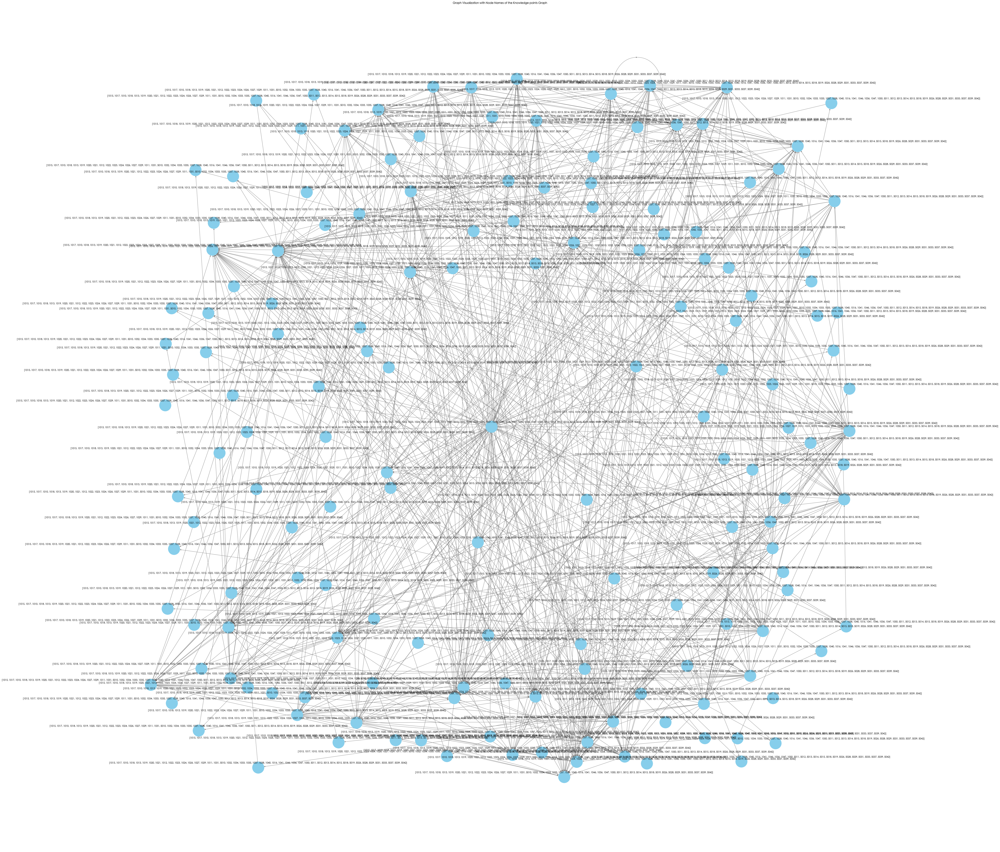

In [16]:
# Visualize:
# (including 'name' as one of the attributes for each node)
# # Set Chinese font
# plt.rcParams['font.sans-serif'] = ['SimHei']  # or any font that supports Chinese
# plt.rcParams['axes.unicode_minus'] = False  # This is needed to display the minus sign correctly
import matplotlib as mpl

# matplotlib.rcParams['font.family'] = ['Heiti TC']

plt.figure(figsize=(50, 50))
# Position nodes using one of the layout algorithms
pos = nx.spring_layout(G_kp, k=0.5, iterations=2)

# Draw the graph
nx.draw(G_kp, pos, with_labels=False, node_color='skyblue', node_size=2500, edge_color='gray', arrows=True)

# Draw the node names as labels above the nodes
for node, (x, y) in pos.items():
    plt.text(x, y+0.01, s=G_course.nodes, horizontalalignment='center', fontsize=10)

plt.title('Graph Visualization with Node Names of the Knowledge points Graph')
plt.show()

In [17]:
print(df_kp.info())
print(df_kp.columns)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 137 entries, 0 to 136
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   zsid    137 non-null    int64 
 1   知识点     137 non-null    object
dtypes: int64(1), object(1)
memory usage: 2.3+ KB
None
Index(['zsid', '知识点'], dtype='object')


In [18]:
df_kp.columns[0]
# df_kp['zsid '][0]

'zsid'

In [19]:
# set the node attributes:
for node in G_kp.nodes():
    # Find the row in df_nodes that matches the node id
    print(node)

1015
1017
1010
1018
1013
1019
1020
1021
1012
1022
1023
1011
5010
1032
1034
1033
1035
1037
1038
1016
1041
1046
1036
1047
1050
5011
5012
5013
5014
5015
5018
5019
5026
5028
5029
5031
5033
5037
5039
5042
12401
12402
12403
12404
12405
12406
12407
12408
12409
12410
12411
12412
12413
12414
12415
12416
12417
12601
12602
12603
12604
12605
12606
12607
12608
12609
12610
12611
12612
12613
12614
12615
12701
12702
12703
12704
12705
12706
12707
12708
12709
12710
12711
12712
12713
12714
12715
12716
12717
12718
12719
12901
12902
12903
12904
12905
12906
12907
12908
12909
12910
12911
12912
12913
12914
12915
12916
12917
12918
12919
12920
12921
12922
12923
12924
12925
12926
12927
12928
13101
13102
13103
13104
13105
13106
13107
13108
13109
13110
13111
13112
13113
13114
13115
13116
13117
14001
14002
14003
14004
14005
14006
14007
14008
14009
14010
14011
14012
14013
14014
14015
14016
14017
14018
14019
14020
14021
14022
14023
14024
14025


In [20]:
li_id = df_kp['zsid'].tolist()
print(li_id)

[12401, 12402, 12403, 12404, 12405, 12406, 12407, 12408, 12409, 12410, 12411, 12412, 12413, 12414, 12415, 12416, 12417, 12501, 12502, 12503, 12504, 12505, 12506, 12507, 12508, 12509, 12510, 12511, 12512, 12513, 12514, 12515, 12516, 12601, 12602, 12603, 12604, 12605, 12606, 12607, 12608, 12609, 12610, 12611, 12612, 12613, 12614, 12615, 12701, 12702, 12703, 12704, 12705, 12706, 12707, 12708, 12709, 12710, 12711, 12712, 12713, 12714, 12715, 12716, 12717, 12718, 12719, 12901, 12902, 12903, 12904, 12905, 12906, 12907, 12908, 12909, 12910, 12911, 12912, 12913, 12914, 12915, 12916, 12917, 12918, 12919, 12920, 12921, 12922, 12923, 12924, 12925, 12926, 12927, 12928, 13101, 13102, 13103, 13104, 13105, 13106, 13107, 13108, 13109, 13110, 13111, 13112, 13113, 13114, 13115, 13116, 13117, 14001, 14002, 14003, 14004, 14005, 14006, 14007, 14008, 14009, 14010, 14011, 14012, 14013, 14014, 14015, 14016, 14017, 14018, 14019, 14020, 14021, 14022, 14023, 14024, 14025]


In [21]:
# set the node attributes:
for node in G_kp.nodes():
    if node in li_id:
        # Find the row in df_nodes that matches the node id
        node_data = df_kp[df_kp['zsid'] == node].iloc[0]
        # Update the node with features from the matching row
        nx.set_node_attributes(G_kp, {node: {'id': node_data['zsid'], 
                                          'knowledge_point': node_data['知识点']}})
    else:
        # Find the row in df_nodes that matches the node id
        node_data = node
        # Update the node with features from the matching row
        nx.set_node_attributes(G_kp, {node: {'id': node_data, 
                                          'knowledge_point': ''}})

In [22]:
for node in G_kp.nodes():
    print(G_kp.nodes[node]['knowledge_point'])









































电路和电路的基本物理量
电阻电感和电容元件
独立电源元件
二极管
双极晶体管
基尔霍夫定律
叠加定理与等效电源定理
正选交流电路
三相交流电路
共发射极放大电路
分立元件组成的基本门电路
逻辑代数运算规则
逻辑函数的表示和化简
组合逻辑电路
集成运算的基本组成
集成运放的基本特性
集成运放的在模拟信号运算方面的应用
产品成本
现金流量与现金流量图
资金的等值换算公式
名义利率与实际利率
时间性评价指标
价值性评价指标
比率性评价指标
互斥方案的优选
独立性项目的经济比较与优选
工程项目财务评价
盈亏平衡分析
敏感性分析
设备磨损
设备的折旧及其计算
投资费用分摊方法
工程材料的概念和分类
材料的物理性质
材料的力学性质
材料的耐久性
水泥的物理性质检验方法
水泥的强度等级评定方法
水泥压力实验和抗折实验方法
混凝土拌合物的性能、测定和调整方法
硬化混凝土的力学、变形性能和耐久性
普通水泥混凝土的配合比设计
砂和石的颗粒级配、粗细程度及狮子的最大粒径的测定
砂的细度模数、级配曲线的确定
砂、石骨料的级配、含水量、含泥量的测定
混凝土和易性的测定及调整方法
混凝土标准养护方法，混凝土强度评定
实验室和施工配合比的确定
工程用钢的品种和选用
砌块和石材的种类和应用
沥青材料的基本组成和结构特点、工程性质及测定方法
水文计算的研究内容
水文现象的基本规律
水文学的研究方法
流域和河系
流域、河系、河道的基本特征
流域面雨量计算
径流及其表示方法
径流的度量单位
径流形成过程
水文测站的分类
水文站网的布设
水文信息手机的途径
水文要素的观测方法
水文数据的处理及整编
重现期的概念
常用的概率分布曲线
水文参数估计方法
水文评率计算适线法
年径流变化及其影响因素
设计洪水的概念、设计标准的确定
流域产流分析
蓄满产流的计算方法
超渗产流的计算方法
流域汇流分析
设计暴雨的计算
由设计暴雨推求设计洪水
小流域设计洪水计算特点
暴雨公式及其具体应用
钢材的破坏形式
钢材主要力学性能及其影响因素
钢材的疲劳特性及验算方法
钢的种类和钢材规格
钢结构的设计方法
钢材和连接的强度设计值及容许应力值
钢结构的对接焊缝
钢结构的角焊缝计算
普通螺栓连接
高强度螺栓连接
梁的整体稳定性概念及保证措施和计算方法
薄

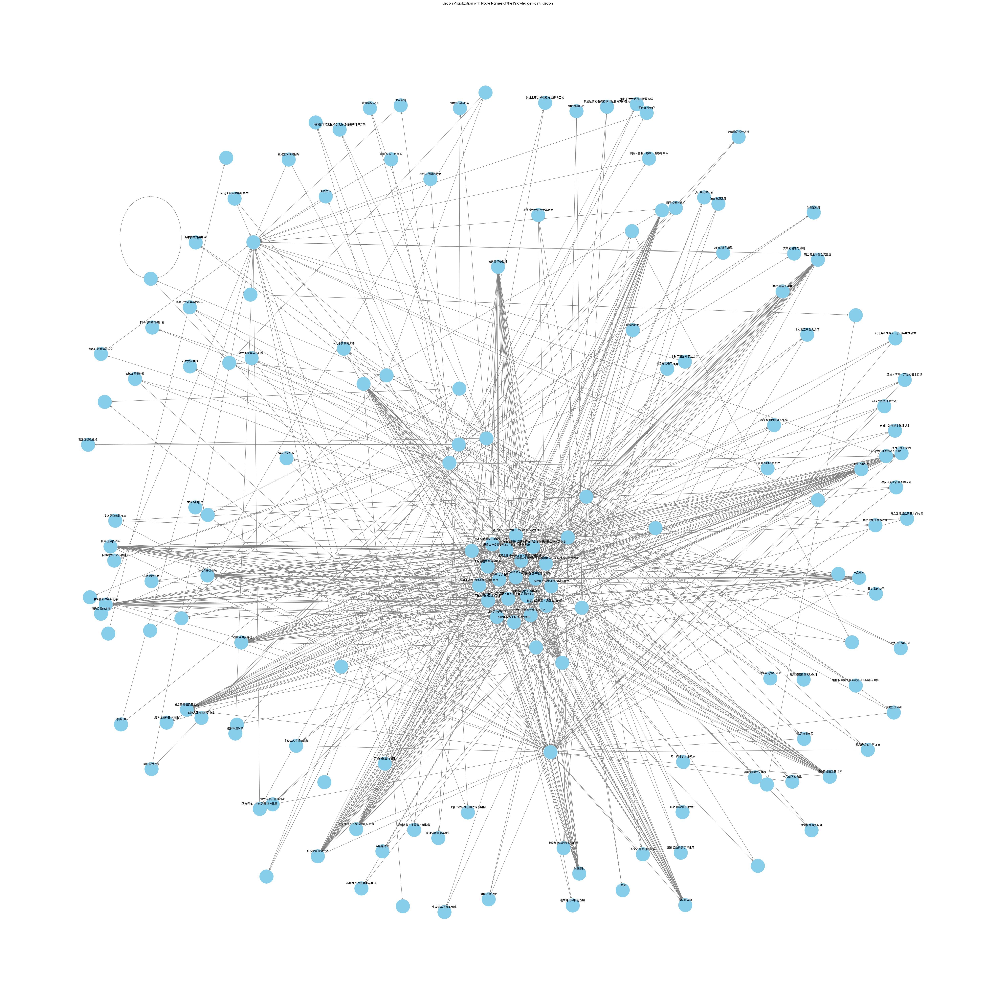

In [57]:
# Visualize:
# (including 'name' as one of the attributes for each node)
# # Set Chinese font
# plt.rcParams['font.sans-serif'] = ['SimHei']  # or any font that supports Chinese
# plt.rcParams['axes.unicode_minus'] = False  # This is needed to display the minus sign correctly
import matplotlib as mpl

matplotlib.rcParams['font.family'] = ['Heiti TC']

plt.figure(figsize=(50, 50))
# Position nodes using one of the layout algorithms
pos = nx.spring_layout(G_kp, k=0.5, iterations=30)

# Draw the graph
nx.draw(G_kp, pos, with_labels=False, node_color='skyblue', node_size=2500, edge_color='gray', arrows=True)

# Draw the node names as labels above the nodes
for node, (x, y) in pos.items():
    plt.text(x, y+0.01, s=G_kp.nodes[node]['knowledge_point'], horizontalalignment='center', fontsize=10)

plt.title('Graph Visualization with Node Names of the Knowledge Points Graph')
plt.show()

## 有很多知识点无描述，考虑去除。将这些知识点的前置后置直接相连

In [23]:
# Step 1: Identify nodes with 'knowledge_point' as empty string
nodes_to_remove = [n for n, attr in G_kp.nodes(data=True) if attr.get('knowledge_point') == '']

print(nodes_to_remove)


[1015, 1017, 1010, 1018, 1013, 1019, 1020, 1021, 1012, 1022, 1023, 1011, 5010, 1032, 1034, 1033, 1035, 1037, 1038, 1016, 1041, 1046, 1036, 1047, 1050, 5011, 5012, 5013, 5014, 5015, 5018, 5019, 5026, 5028, 5029, 5031, 5033, 5037, 5039, 5042]


In [24]:
# Step 2: For each node, connect its predecessors to its successors
for node in nodes_to_remove:
    predecessors = list(G_kp.predecessors(node))
    successors = list(G_kp.successors(node))
    
    # Create direct edges from predecessors to successors
    for pred in predecessors:
        for succ in successors:
            # Add an edge if it doesn't already exist to avoid duplicate edges
            if not G_kp.has_edge(pred, succ):
                G_kp.add_edge(pred, succ)

# Step 3: Remove the nodes
G_kp.remove_nodes_from(nodes_to_remove)

In [25]:
graph_investigation(G_kp)

Number of nodes: 121
Number of edges: 285
Is the graph directed? True
Degrees: {12401: 0, 12402: 0, 12403: 0, 12404: 0, 12405: 0, 12406: 0, 12407: 0, 12408: 0, 12409: 0, 12410: 0, 12411: 0, 12412: 0, 12413: 0, 12414: 0, 12415: 0, 12416: 0, 12417: 0, 12601: 19, 12602: 19, 12603: 19, 12604: 19, 12605: 19, 12606: 19, 12607: 19, 12608: 19, 12609: 19, 12610: 19, 12611: 19, 12612: 19, 12613: 19, 12614: 19, 12615: 19, 12701: 15, 12702: 15, 12703: 15, 12704: 15, 12705: 15, 12706: 15, 12707: 15, 12708: 15, 12709: 15, 12710: 15, 12711: 15, 12712: 15, 12713: 15, 12714: 15, 12715: 15, 12716: 15, 12717: 15, 12718: 15, 12719: 15, 12901: 0, 12902: 0, 12903: 0, 12904: 0, 12905: 0, 12906: 0, 12907: 0, 12908: 0, 12909: 0, 12910: 0, 12911: 0, 12912: 0, 12913: 0, 12914: 0, 12915: 0, 12916: 0, 12917: 0, 12918: 0, 12919: 0, 12920: 0, 12921: 0, 12922: 0, 12923: 0, 12924: 0, 12925: 0, 12926: 0, 12927: 0, 12928: 0, 13101: 0, 13102: 0, 13103: 0, 13104: 0, 13105: 0, 13106: 0, 13107: 0, 13108: 0, 13109: 0, 13110:

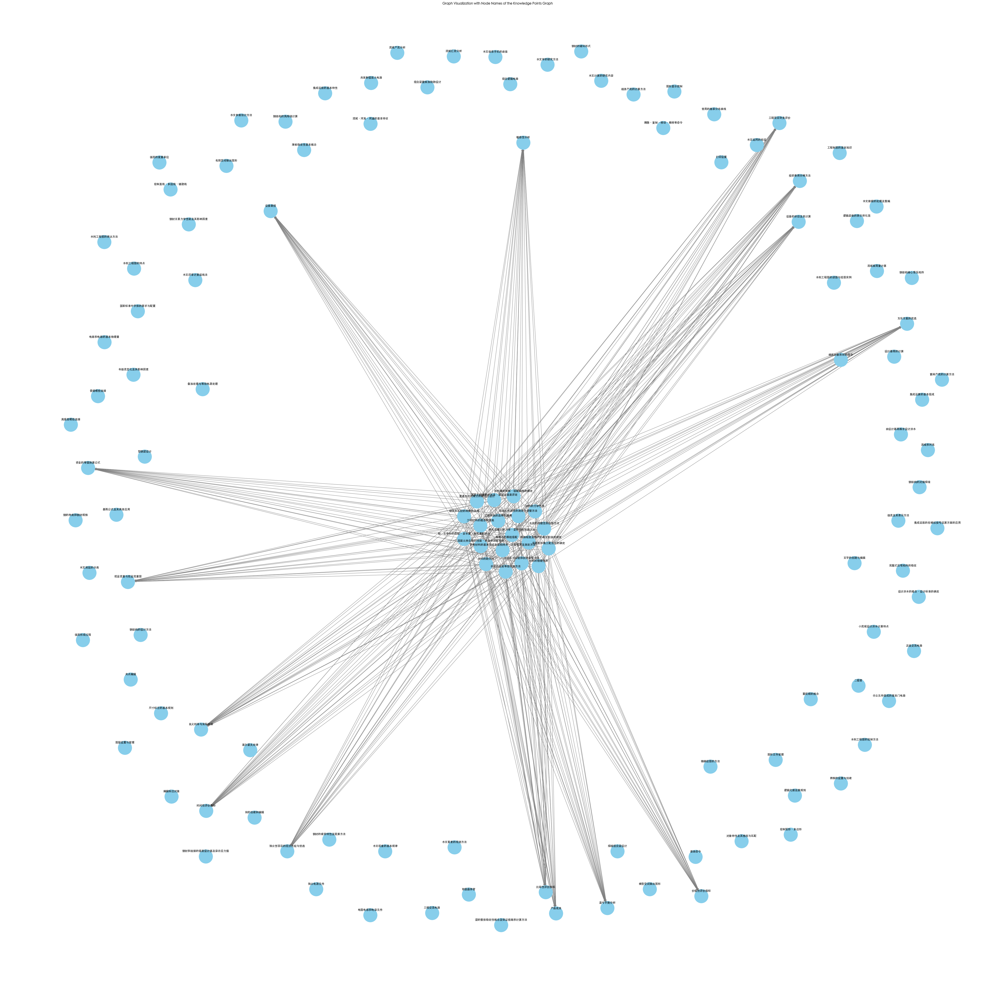

In [26]:
# Visualize:
# (including 'name' as one of the attributes for each node)
# # Set Chinese font
# plt.rcParams['font.sans-serif'] = ['SimHei']  # or any font that supports Chinese
# plt.rcParams['axes.unicode_minus'] = False  # This is needed to display the minus sign correctly
import matplotlib as mpl

matplotlib.rcParams['font.family'] = ['Heiti TC']

plt.figure(figsize=(50, 50))
# Position nodes using one of the layout algorithms
pos = nx.spring_layout(G_kp, k=0.5, iterations=30)

# Draw the graph
nx.draw(G_kp, pos, with_labels=False, node_color='skyblue', node_size=2500, edge_color='gray', arrows=True)

# Draw the node names as labels above the nodes
for node, (x, y) in pos.items():
    plt.text(x, y+0.01, s=G_kp.nodes[node]['knowledge_point'], horizontalalignment='center', fontsize=10)

plt.title('Graph Visualization with Node Names of the Knowledge Points Graph')
plt.show()

In [62]:
G_kp_final = G_kp.copy()

# Identify disconnected nodes (no incoming and no outgoing edges)
disconnected_nodes = [node for node in G_kp_final.nodes() if G_kp_final.in_degree(node) == 0 and G_kp_final.out_degree(node) == 0]

# Remove the disconnected nodes from the graph
G_kp_final.remove_nodes_from(disconnected_nodes)

# Optionally, print out the removed nodes or the number of them
print(f"Removed {len(disconnected_nodes)} disconnected nodes: {disconnected_nodes}")


Removed 87 disconnected nodes: [12401, 12402, 12403, 12404, 12405, 12406, 12407, 12408, 12409, 12410, 12411, 12412, 12413, 12414, 12415, 12416, 12417, 12901, 12902, 12903, 12904, 12905, 12906, 12907, 12908, 12909, 12910, 12911, 12912, 12913, 12914, 12915, 12916, 12917, 12918, 12919, 12920, 12921, 12922, 12923, 12924, 12925, 12926, 12927, 12928, 13101, 13102, 13103, 13104, 13105, 13106, 13107, 13108, 13109, 13110, 13111, 13112, 13113, 13114, 13115, 13116, 13117, 14001, 14002, 14003, 14004, 14005, 14006, 14007, 14008, 14009, 14010, 14011, 14012, 14013, 14014, 14015, 14016, 14017, 14018, 14019, 14020, 14021, 14022, 14023, 14024, 14025]


In [63]:
graph_investigation(G_kp_final)

Number of nodes: 34
Number of edges: 285
Is the graph directed? True
Degrees: {12601: 19, 12602: 19, 12603: 19, 12604: 19, 12605: 19, 12606: 19, 12607: 19, 12608: 19, 12609: 19, 12610: 19, 12611: 19, 12612: 19, 12613: 19, 12614: 19, 12615: 19, 12701: 15, 12702: 15, 12703: 15, 12704: 15, 12705: 15, 12706: 15, 12707: 15, 12708: 15, 12709: 15, 12710: 15, 12711: 15, 12712: 15, 12713: 15, 12714: 15, 12715: 15, 12716: 15, 12717: 15, 12718: 15, 12719: 15}
In-degrees: {12601: 19, 12602: 19, 12603: 19, 12604: 19, 12605: 19, 12606: 19, 12607: 19, 12608: 19, 12609: 19, 12610: 19, 12611: 19, 12612: 19, 12613: 19, 12614: 19, 12615: 19, 12701: 0, 12702: 0, 12703: 0, 12704: 0, 12705: 0, 12706: 0, 12707: 0, 12708: 0, 12709: 0, 12710: 0, 12711: 0, 12712: 0, 12713: 0, 12714: 0, 12715: 0, 12716: 0, 12717: 0, 12718: 0, 12719: 0}
Out-degrees: {12601: 0, 12602: 0, 12603: 0, 12604: 0, 12605: 0, 12606: 0, 12607: 0, 12608: 0, 12609: 0, 12610: 0, 12611: 0, 12612: 0, 12613: 0, 12614: 0, 12615: 0, 12701: 15, 1270

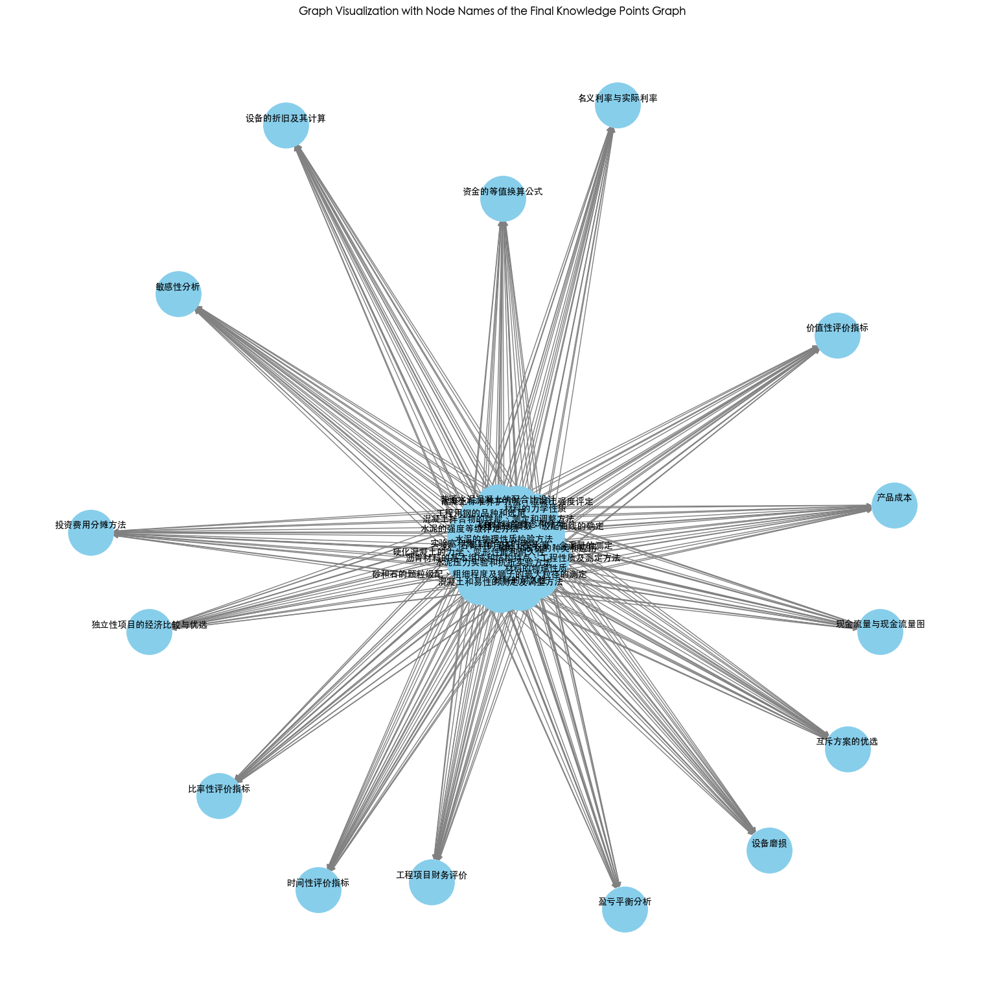

In [65]:
# Visualize:
# (including 'name' as one of the attributes for each node)
# # Set Chinese font
# plt.rcParams['font.sans-serif'] = ['SimHei']  # or any font that supports Chinese
# plt.rcParams['axes.unicode_minus'] = False  # This is needed to display the minus sign correctly
import matplotlib as mpl

matplotlib.rcParams['font.family'] = ['Heiti TC']

plt.figure(figsize=(15, 15))
# Position nodes using one of the layout algorithms
pos = nx.spring_layout(G_kp_final, k=0.5, iterations=30)

# Draw the graph
nx.draw(G_kp_final, pos, with_labels=False, node_color='skyblue', node_size=2500, edge_color='gray', arrows=True)

# Draw the node names as labels above the nodes
for node, (x, y) in pos.items():
    plt.text(x, y+0.01, s=G_kp_final.nodes[node]['knowledge_point'], horizontalalignment='center', fontsize=10)

plt.title('Graph Visualization with Node Names of the Final Knowledge Points Graph')
plt.show()

In [27]:
# Store the course graph
# Store it:
file_name_kp = 'WDKG-KnowledgePoints.graphml'

nx.write_graphml(G_kp, file_name_kp)